In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly_express as px
import json

In [2]:
#read in data
data = pd.read_csv('311_Service_Requests_from_2010_to_Present_20240417.csv')
data['Created Date'] = pd.to_datetime(data['Created Date'], format="%m/%d/%Y %I:%M:%S %p")
data['Closed Date'] = pd.to_datetime(data['Closed Date'], format="%m/%d/%Y %I:%M:%S %p")
data.head()

C:\Users\poczt\AppData\Local\Temp\ipykernel_21384\294620695.py:2: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('311_Service_Requests_from_2010_to_Present_20240417.csv')


,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location
0,59889383,2023-12-31 23:59:42,2024-01-01 01:51:01,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,11375.0,63-10 108 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.734695,-73.850521,"(40.734694673156454, -73.85052125577377)"
1,59887573,2023-12-31 23:59:39,2024-01-19 14:37:37,EDC,Economic Development Corporation,Noise - Helicopter,Other,Above Address,10023.0,25 WEST 73 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.777201,-73.976159,"(40.77720102455921, -73.976158989108)"
2,59893860,2023-12-31 23:59:29,2024-01-01 01:51:32,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,11374.0,65-09 99 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.729379,-73.855433,"(40.72937885745978, -73.85543290785074)"
3,59887231,2023-12-31 23:59:23,2024-01-01 00:13:30,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,11232.0,870 42 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.644725,-73.997622,"(40.64472479285036, -73.9976217135385)"
4,59889382,2023-12-31 23:59:13,2024-01-01 01:50:57,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,11375.0,63-10 108 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.734695,-73.850521,"(40.734694673156454, -73.85052125577377)"


In [3]:
# Total size of your data
print(f"Number of rows: {data.shape[0]}")
print(f"Number of columns: {data.shape[1]}")

# Other properties
min_date = data['Created Date'].min()
max_date = data['Created Date'].max()
date_range = max_date - min_date
print(f"Date range: {date_range.days} days, from {min_date} to {max_date}")

unique_types = data['Complaint Type'].nunique()
print(f"Number of unique types: {unique_types}")
print(data['Complaint Type'].unique())

Number of rows: 686231
Number of columns: 41
Date range: 364 days, from 2023-01-01 00:00:42 to 2023-12-31 23:59:42
Number of unique types: 8
['Noise - Street/Sidewalk' 'Noise - Helicopter' 'Noise - Residential'
 'Noise - Commercial' 'Noise - Vehicle' 'Noise' 'Noise - Park'
 'Noise - House of Worship']


In [4]:
def plot_count(data, column_name, sideway_label=False):
    plt.figure(figsize=(7, 4))
    plt.bar(data[column_name], data['count'], color='skyblue')
    if sideway_label:
        plt.xticks(rotation=90)
    plt.xlabel(column_name)
    plt.ylabel('Count')
    plt.title(f'Count of {column_name}')
    plt.show()

In [5]:
data.Borough = data.Borough.str.title()
grouped_borough = data.groupby(['Borough']).size().reset_index(name='count')
print(grouped_borough)

         Borough   count
0          Bronx  141299
1       Brooklyn  186915
2      Manhattan  196766
3         Queens  145639
4  Staten Island   15098
5    Unspecified     514


In [6]:
print('No zip code:',data['Incident Zip'].isnull().sum())

No zip code: 526


In [7]:
zip_to_borough = {'10282': 'Manhattan',
                  '10314': 'Staten Island',
                  '10475': 'Bronx',
                  '11697': 'Queens',
                  '11256': 'Brooklyn'}
def map_borough(row):
    if row['Borough'] == 'Unspecified':
        for zip_code, borough in zip_to_borough.items():
            if row['Incident Zip'] <= float(zip_code):
                return borough
    return row['Borough']
data['Borough'] = data.apply(map_borough, axis=1)
grouped_zip = data.groupby(['Incident Zip','Borough']).size().reset_index(name='count')
print(grouped_zip.shape[0])
print(grouped_zip.sort_values(by='count', ascending=False))

224
     Incident Zip    Borough  count
21        10023.0  Manhattan  15925
23        10025.0  Manhattan  13763
92        10456.0      Bronx  12954
29        10031.0  Manhattan  12543
93        10457.0      Bronx  11630
..            ...        ...    ...
41        10045.0  Manhattan      1
39        10041.0  Manhattan      1
113       10803.0      Bronx      1
186       11371.0     Queens      1
63        10165.0  Manhattan      1

[224 rows x 3 columns]


In [8]:
with open('new-york-zip-codes-_1604.geojson') as file:
    nyc_boroughs = json.load(file)

max_val = max(grouped_zip['count'])
min_val = min(grouped_zip['count'])
fig = px.choropleth_mapbox(grouped_zip, 
                           geojson=nyc_boroughs, 
                           locations='Incident Zip', 
                           featureidkey='properties.ZCTA5CE10',
                           color='count',
                           mapbox_style="carto-positron",
                           zoom=9, 
                           center = {"lat": data.Latitude.mean(), "lon": data.Longitude.mean()},
                           range_color=(min_val, max_val),
                           color_continuous_scale="Oranges",
                           opacity=0.5,
                           hover_data=['Borough']
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [9]:
data['Hour'] = data['Created Date'].dt.hour
grouped_zip_hour = data.groupby(['Incident Zip','Borough','Hour']).size().reset_index(name='count')

max_val = max(grouped_zip_hour['count'])
min_val = min(grouped_zip_hour['count'])

In [10]:
with open('new-york-zip-codes-_1604.geojson') as file:
    nyc_boroughs = json.load(file)

fig = px.choropleth_mapbox(grouped_zip_hour, 
                           geojson=nyc_boroughs, 
                           locations='Incident Zip', 
                           featureidkey='properties.ZCTA5CE10',
                        #    animation_frame='Hour',
                           color='count',
                           mapbox_style="carto-positron",
                           zoom=8.8, 
                           center = {"lat": data.Latitude.mean(), "lon": data.Longitude.mean()},
                           range_color=(min_val, max_val),
                           color_continuous_scale="Oranges",
                           opacity=0.5,
                           hover_data=['Borough'],
                           height=500
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# output cleared here cause the time map is too big to put on github LOL

In [11]:
with open('new-york-city-boroughs.geojson') as file:
    nyc_boroughs = json.load(file)

max_val = max(grouped_borough['count'])
min_val = min(grouped_borough['count'])
fig = px.choropleth_mapbox(grouped_borough, 
                           geojson=nyc_boroughs, 
                           locations='Borough', 
                           featureidkey='properties.name',
                           color='count',
                           mapbox_style="carto-positron",
                           zoom=9, 
                           center = {"lat": data.Latitude.mean(), "lon": data.Longitude.mean()},
                           range_color=(min_val, max_val),
                           color_continuous_scale="Oranges",
                           opacity=0.6
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

             Complaint Type   count
0       Noise - Residential  298453
1   Noise - Street/Sidewalk  147449
2        Noise - Commercial   67749
3        Noise - Helicopter   59127
4                     Noise   52646
5           Noise - Vehicle   51256
6              Noise - Park    8306
7  Noise - House of Worship    1245


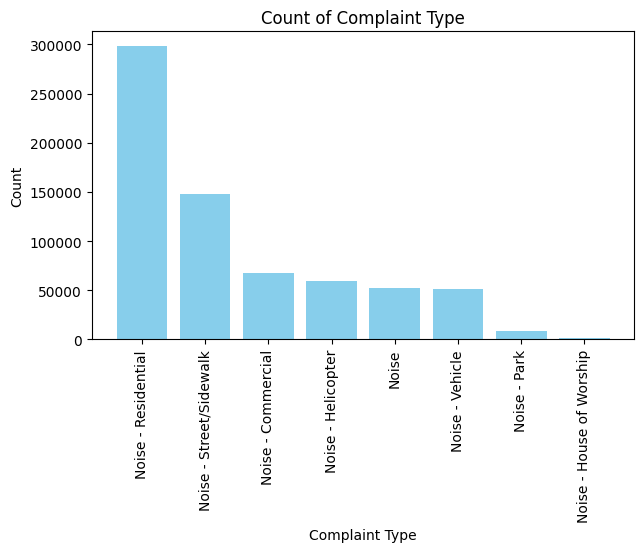

In [12]:
grouped_type = data.groupby(['Complaint Type']).size().reset_index(name='count').sort_values(by='count', ascending=False, ignore_index=True)
grouped_type_location = data.groupby(['Complaint Type','Location Type']).size().reset_index(name='count').sort_values(by='count', ascending=False, ignore_index=True)
print(grouped_type.sort_values(by='count', ascending=False))
plot_count(grouped_type, 'Complaint Type', sideway_label=True)

         Descriptor               Location Type   count
0  Loud Music/Party  Residential Building/House  174117
1  Banging/Pounding  Residential Building/House   97628
2      Loud Talking  Residential Building/House   21802
3   Loud Television  Residential Building/House    4906


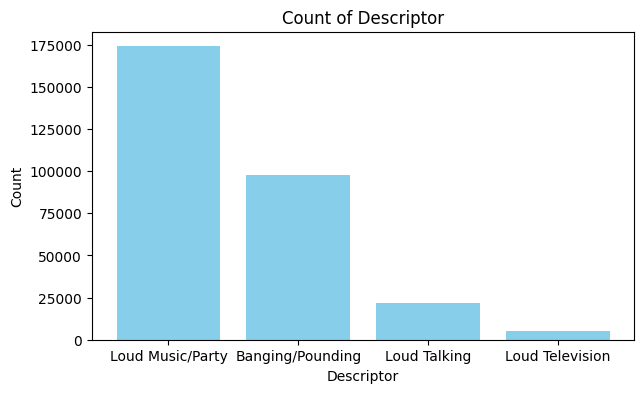

In [13]:
residential = data[data['Complaint Type']=='Noise - Residential']
grouped_residential = residential.groupby(['Descriptor','Location Type']).size().reset_index(name='count').sort_values(by='count', ascending=False, ignore_index=True)
print(grouped_residential)
plot_count(grouped_residential, 'Descriptor')

In [14]:
party_complaints = data[data.Descriptor == 'Loud Music/Party']
group_party = party_complaints.groupby(['Incident Zip','Borough']).size().reset_index(name='count')
print(group_party.sort_values(by='count', ascending=False))

with open('new-york-zip-codes-_1604.geojson') as file:
    nyc_boroughs = json.load(file)

max_val = max(group_party['count'])
min_val = min(group_party['count'])
fig = px.choropleth_mapbox(group_party, 
                           geojson=nyc_boroughs, 
                           locations='Incident Zip', 
                           featureidkey='properties.ZCTA5CE10',
                           color='count',
                           mapbox_style="carto-positron",
                           zoom=9, 
                           center = {"lat": data.Latitude.mean(), "lon": data.Longitude.mean()},
                           range_color=(min_val, max_val),
                           color_continuous_scale="Oranges",
                           opacity=0.5,
                           hover_data=['Borough']
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

     Incident Zip    Borough  count
82        10456.0      Bronx   8297
29        10031.0  Manhattan   8273
83        10457.0      Bronx   7752
78        10452.0      Bronx   7510
30        10032.0  Manhattan   6994
..            ...        ...    ...
43        10103.0  Manhattan      1
61        10278.0  Manhattan      1
62        10279.0  Manhattan      1
105       11005.0     Queens      1
173       11370.0      Bronx      1

[212 rows x 3 columns]


  Open Data Channel Type   count
0                 ONLINE  213620
1                 MOBILE   54124
2                  PHONE   30689
3                UNKNOWN      15
4                  OTHER       5


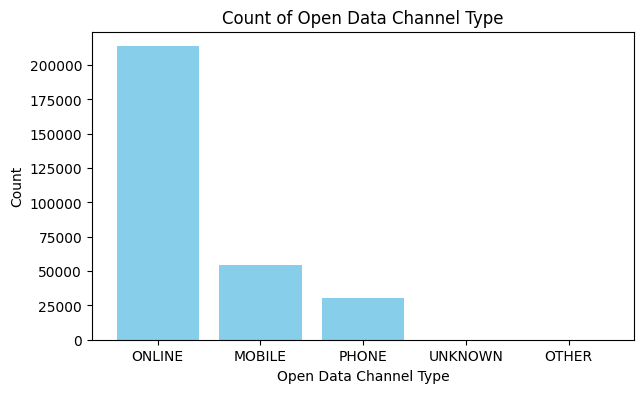

In [15]:
grouped_channel = residential.groupby(['Open Data Channel Type']).size().reset_index(name='count')
grouped_channel.sort_values(by='count', ascending=False, inplace=True, ignore_index=True)
print(grouped_channel)
plot_count(grouped_channel, 'Open Data Channel Type')

In [16]:
print(data.Descriptor.unique())

['Loud Music/Party' 'Other' 'Banging/Pounding' 'Loud Talking'
 'Car/Truck Music' 'Noise, Barking Dog (NR5)' 'Noise: Alarms (NR3)'
 'Car/Truck Horn' 'Loud Television' 'NYPD'
 'Noise: Construction Before/After Hours (NM1)' 'Engine Idling'
 'Noise: Construction Equipment (NC1)'
 'Noise: air condition/ventilation equipment (NV1)' 'News Gathering'
 'Noise: Jack Hammering (NC2)' 'Noise: Private Carting Noise (NQ1)'
 'Noise, Ice Cream Truck (NR4)' 'Noise: Manufacturing Noise (NK1)'
 'Noise:  lawn care equipment (NCL)' 'Noise, Other Animals (NR6)'
 'Noise: Boat(Engine,Music,Etc) (NR10)'
 'Noise: Other Noise Sources (Use Comments) (NZZ)'
 'Noise: Loud Music/Daytime (Mark Date And Time) (NN1)']


Index(['Unique Key', 'Created Date', 'Closed Date', 'Agency', 'Agency Name',
       'Complaint Type', 'Descriptor', 'Location Type', 'Incident Zip',
       'Incident Address', 'Street Name', 'Cross Street 1', 'Cross Street 2',
       'Intersection Street 1', 'Intersection Street 2', 'Address Type',
       'City', 'Landmark', 'Facility Type', 'Status', 'Due Date',
       'Resolution Description', 'Resolution Action Updated Date',
       'Community Board', 'BBL', 'Borough', 'X Coordinate (State Plane)',
       'Y Coordinate (State Plane)', 'Open Data Channel Type',
       'Park Facility Name', 'Park Borough', 'Vehicle Type',
       'Taxi Company Borough', 'Taxi Pick Up Location', 'Bridge Highway Name',
       'Bridge Highway Direction', 'Road Ramp', 'Bridge Highway Segment',
       'Latitude', 'Longitude', 'Location', 'Hour'],
      dtype='object')


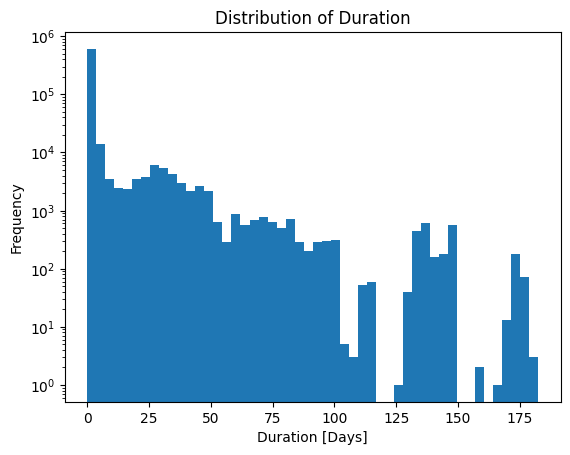

In [17]:
print(data.columns)
data['Duration'] = data['Closed Date'] - data['Created Date']
data['Duration_in_minutes'] = data['Duration'].dt.total_seconds() / 86400


plt.hist(data['Duration_in_minutes'], bins=50)
plt.title('Distribution of Duration')
plt.xlabel('Duration [Days]')
plt.yscale('log')
plt.ylabel('Frequency')
plt.show()


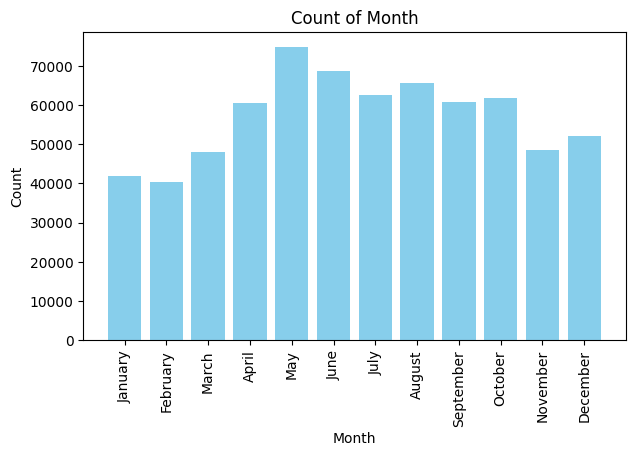

In [18]:
def map_month_name(row):
    return row['Created Date'].month_name()
grouped_month = data.set_index('Created Date').resample('M').size().reset_index(name='count')
grouped_month['Month'] = grouped_month.apply(map_month_name, axis=1)
plot_count(grouped_month, 'Month', sideway_label=True)

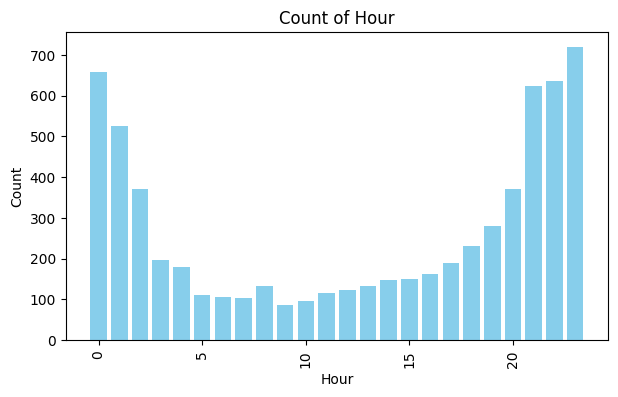

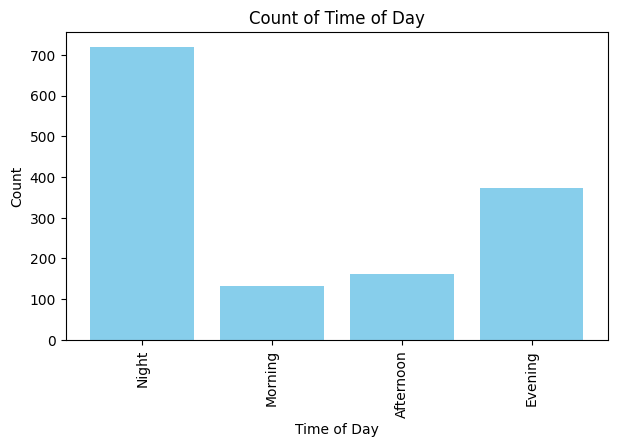

In [19]:
def map_time_of_day(row):
    hour = row['Created Date'].hour
    if 5 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 21:
        return 'Evening'
    else:
        return 'Night'
    
def map_hour(row):
    return row['Created Date'].hour

grouped_time_of_day = data.set_index('Created Date').resample('H').size().reset_index(name='count')
grouped_time_of_day['Time of Day'] = grouped_time_of_day.apply(map_time_of_day, axis=1)
grouped_time_of_day['Hour'] = grouped_time_of_day.apply(map_hour, axis=1)
plot_count(grouped_time_of_day, 'Hour', sideway_label=True)
plot_count(grouped_time_of_day, 'Time of Day', sideway_label=True)
